# Otras alternativas para manipulación de audio

### <span style="color:RoyalBlue">Reproducción automática de un archivo de audio</span> 


In [3]:
from IPython.display import Audio
sound_file = './sounds/mixkit-arcade-bonus-alert-767.wav'

Audio(sound_file, autoplay=True)


### <span style="color:RoyalBlue">Elementos interactivos para manipulación de audio</span> 

In [3]:
import numpy as np
from IPython.display import Audio
from ipywidgets import interact

def beat_freq(f1=220.0, f2=224.0):
    max_time = 3
    times = np.linspace(0, max_time, int(44100*max_time))
    signal = np.sin(2*np.pi*f1*times) + np.sin(2*np.pi*f2*times)
    return Audio(data=signal, rate=44100)

interact(beat_freq, f1=(200.0,300.0), f2=(200.0,300.0));

interactive(children=(FloatSlider(value=220.0, description='f1', max=300.0, min=200.0), FloatSlider(value=224.…

### <span style="color:RoyalBlue">Alternativas para manipulación de audio</span> 

Channels: 2
Sample width: 2
Frame rate (sample rate): 44100
Frame width: 4
Length (ms): 2026
Frame count: 89332.0
Intensity: -19.365816272646008


C:\Users\Diego\AppData\Local\Temp\ipykernel_9028\3536516943.py:38: FutureWarning: Pass sr=44100 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  librosa.display.waveshow(x, sr)


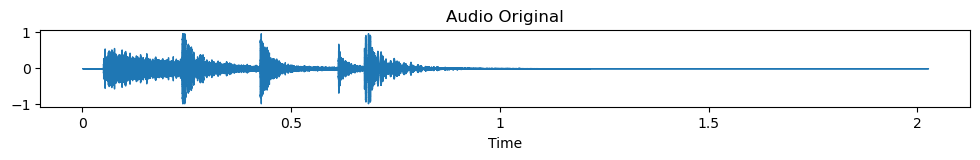

In [9]:
# Se pueden instalar desde una terminal de Anaconda:
# conda install -c conda-forge pydub
# conda install -c conda-forge librosa


import os
import numpy as np

from pydub import AudioSegment, effects
import librosa
#import noisereduce as nr

import matplotlib.pyplot as plt
from librosa import display   
import IPython.display as ipd

from pydub import AudioSegment, effects
#import librosa
#from librosa import display
#import matplotlib.pyplot as plt

path_raw = "./sounds/mixkit-bad-joke-drums-2893.wav"
raw_sound = AudioSegment.from_file(path_raw)

# Print attributes
print(f"Channels: {raw_sound.channels}")
print(f"Sample width: {raw_sound.sample_width}")
print(f"Frame rate (sample rate): {raw_sound.frame_rate}")
print(f"Frame width: {raw_sound.frame_width}")
print(f"Length (ms): {len(raw_sound)}")
print(f"Frame count: {raw_sound.frame_count()}")
print(f"Intensity: {raw_sound.dBFS}")

x, sr = librosa.load(path_raw, sr = None)

# Gráfica de la señal de audio original
plt.figure(figsize=(12,1))
librosa.display.waveshow(x, sr)
plt.title('Audio Original')
raw_sound


Channels: 2
Sample width: 2
Frame rate (sample rate): 44100
Frame width: 4
Length (ms): 2026
Frame count: 89332.0
Intensity: -24.103631366545404


C:\Users\Diego\AppData\Local\Temp\ipykernel_9028\2344057239.py:17: FutureWarning: Pass sr=44100 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  librosa.display.waveshow(normal_x, sr)


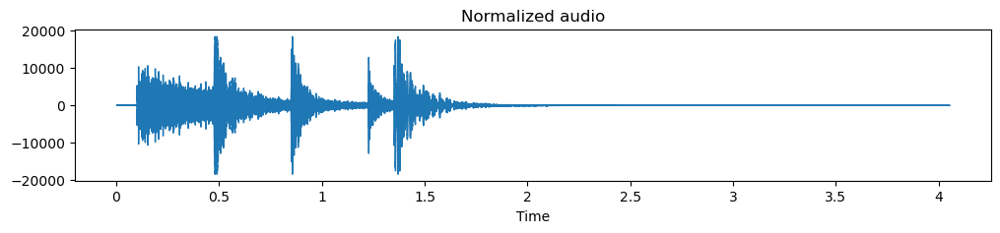

In [10]:
# Normalización a +5.0 dBFS
normalizedsound = effects.normalize(raw_sound, headroom = 5.0) 
normal_x = np.array(normalizedsound.get_array_of_samples(), dtype = 'float32')
path_processed = "./sounds/normalized_sound.wav"
normalizedsound.export(path_processed, format="wav")

# Print attributes
print(f"Channels: {normalizedsound.channels}")
print(f"Sample width: {normalizedsound.sample_width}")
print(f"Frame rate (sample rate): {raw_sound.frame_rate}")
print(f"Frame width: {normalizedsound.frame_width}")
print(f"Length (ms): {len(normalizedsound)}")
print(f"Frame count: {normalizedsound.frame_count()}")
print(f"Intensity: {normalizedsound.dBFS}")

plt.figure(figsize=(12,2))
librosa.display.waveshow(normal_x, sr)
plt.title('Normalized audio')

normalizedsound

### <span style="color:RoyalBlue">Mezcla de señales</span> 

In [11]:
from IPython.display import Audio
from pydub import AudioSegment

# Load the sounds
city_sounds = AudioSegment.from_file("./sounds/street-noise.mp3")

city_sounds

In [14]:
bird_song = AudioSegment.from_file("./sounds/ambiance-quiet-city-park.mp3")

# Overlay them
soundscape = city_sounds.overlay(bird_song - 10)
soundscape.export("soundscape.wav", format="wav")

bird_song

In [13]:
# Mezcla de las señales
Audio("soundscape.wav")